<a href="https://colab.research.google.com/github/SimoneFarallo/SimoneFarallo/blob/main/Load_%26_Pre_process.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Tesi magistrale**

https://it.overleaf.com/project/6502e44ee97a5ee4dea30d17



# Libraries

In [1]:
!pip install spacy  transformers https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.4.0/en_core_sci_md-0.4.0.tar.gz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.2/125.2 MB 4.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.1/311.1 kB 19.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 25.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 34.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 38.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 659.5/659.5 kB 23.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.8/82.8 kB 10.3 MB/s eta 0:00:00
  Created wheel for en-core-sci-md: filename=en_core_sci_md-0.4.0-py3-none-any.whl size=125733907 sha256=bf9a7daa5cf42cee3b60d392fe2b180c80164ef2d091

In [2]:
!python -m spacy download en_core_web_sm


2023-11-14 08:37:33.599198: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-11-14 08:37:33.599272: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-11-14 08:37:33.599367: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-11-14 08:37:33.613430: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-11-14 08:37:35.940711: W tensorflow/compiler/

In [3]:
import pandas as pd
import networkx as nx
import time
import random
import matplotlib.pyplot as plt
import spacy
import torch
import pandas as pd
from transformers import AutoModel, AutoTokenizer
from transformers import BertTokenizer, BertModel


In [4]:
# Carica il modello di spaCy
nlp = spacy.load("en_core_sci_md") #campo medico

#nlp = spacy.load("en_core_web_sm") #lingua inglese

/usr/local/lib/python3.10/dist-packages/torch/__init__.py:614: UserWarning: torch.set_default_tensor_type() is deprecated as of PyTorch 2.1, please use torch.set_default_dtype() and torch.set_default_device() as alternatives. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:451.)
  _C._set_default_tensor_type(t)


# Load & Build Knowledge Graph
* KG: https://lhncbc.nlm.nih.gov/ii/tools/SemRep_SemMedDB_SKR/SemMedDB_download.html

In [5]:
kg = pd.read_csv ('/content/drive/MyDrive/Tesi & Stage/Code/semmedVER43_2023_R_PREDICATION.csv.gz',encoding='ISO-8859-1',header=None,usecols =[3, 5, 9, 10]  ,nrows = 1000000)

In [6]:
kg.columns

Int64Index([3, 5, 9, 10], dtype='int64')

In [7]:
kg = kg[[3, 5, 9,10]]
nuovi_nomi_colonne = ["PREDICATE", "SUBJECT_NAME", "OBJECT_NAME","OBJECT_SEMTYPE"]  # Sostituisci con i nuovi nomi delle colonne
kg.columns = nuovi_nomi_colonne
kg

,PREDICATE,SUBJECT_NAME,OBJECT_NAME,OBJECT_SEMTYPE
0,PROCESS_OF,Arboviruses,Lepus capensis,mamm
1,ISA,Tahyna virus,California Group Viruses,virs
2,ISA,Eyach virus,Coltivirus,virs
3,ISA,California Group Viruses,Arboviruses,virs
4,PROCESS_OF,Disease,Human,humn
...,...,...,...,...
999995,INHIBITS,Cyclic GMP,tadalafil,orch
999996,PREDISPOSES,"20-hydroxy-5,8,11,14-eicosatetraenoic acid",Hypertensive disease,dsyn
999997,AFFECTS,Disulfiram,Cell Death,celf
999998,PREVENTS,Walking,Osteoporosis,dsyn


In [8]:
print(f"Predicato: {len(kg['PREDICATE'].unique())}")
print(f"Soggetto: {len(kg['SUBJECT_NAME'].unique())}")
print(f"Oggetto: {len(kg['OBJECT_NAME'].unique())}")

Predicato: 63
Soggetto: 59159
Oggetto: 50035


## Build Graph

In [9]:
G = nx.Graph()

# Iterazione attraverso le righe del dataframe e aggiunta degli edge al grafo
start_time = time.time()

for _, row in kg.iterrows():
    G.add_edge(row['OBJECT_NAME'], row['SUBJECT_NAME'], label=row['PREDICATE'])

end_time = time.time()

# Calcolo del tempo di esecuzione
execution_time = end_time - start_time
print(f"Tempo di esecuzione: {execution_time} secondi")

Tempo di esecuzione: 72.86053919792175 secondi


In [10]:
# Number of edges
print(G.number_of_edges())
print(len(G.nodes))

515518
72254


In [11]:
G.nodes

NodeView(('Lepus capensis', 'Arboviruses', 'California Group Viruses', 'Tahyna virus', 'Coltivirus', 'Eyach virus', 'Human', 'Disease', 'Virus', 'Antibodies', 'FHL1', 'Binding Protein', 'Borrelia burgdorferi', 'COMPLEMENT FACTOR H|CFH', 'XS', 'homocysteine', 'Methionine', 'Bacteria', 'Gene Expression', 'Pheromone', 'Adult', 'B.S.S.', 'Vertebrates', 'host', 'Animals', 'Farm Animals', 'Microbicides', 'Therapeutic procedure', 'Fluoroquinolones', 'enrofloxacin', 'Pharmaceutical Preparations', 'Tick-Borne Encephalitis', 'Covers', 'Behavior', 'Infection', 'Patients', 'Fever', 'Females', 'Males', '16s', 'Recombinant DNA', 'Individual', 'Tick-Borne Infections', 'Glossitis, Benign Migratory', 'Symptoms', 'Lyme Disease', 'Diagnosis', 'Immunofluorescence', 'Disorder characterized by fever', '1-oleoyl-2-stearoylphosphatidylcholine', '4,5-dibromo-2-pyrrolic acid', 'DNA', 'Specific antigen', 'Inflammation', 'Neuropeptides', 'Autoimmunity', 'Crosstalk', 'T-Lymphocyte', 'neuropeptide Y|NPY', 'Antigen-

In [12]:
G.edges

EdgeView([('Lepus capensis', 'Arboviruses'), ('Lepus capensis', 'Antibodies'), ('Lepus capensis', 'Syndrome'), ('Arboviruses', 'California Group Viruses'), ('Arboviruses', 'Ephemeral Fever'), ('Arboviruses', 'Vaccination'), ('Arboviruses', 'Virus'), ('Arboviruses', 'RNA'), ('Arboviruses', 'Japanese encephalitis virus'), ('Arboviruses', 'Japanese Encephalitis'), ('Arboviruses', 'Dengue Virus'), ('Arboviruses', 'Rift Valley fever virus'), ('Arboviruses', 'Disease'), ('Arboviruses', 'Semliki forest virus'), ('Arboviruses', 'West Nile virus'), ('Arboviruses', 'Antigens'), ('Arboviruses', 'Amazona'), ('Arboviruses', "Little's Disease"), ('Arboviruses', 'Ruminants'), ('Arboviruses', 'Human'), ('Arboviruses', 'Chikungunya virus'), ('Arboviruses', 'Encephalitis Virus, Murray Valley'), ('California Group Viruses', 'Tahyna virus'), ('California Group Viruses', 'Orthobunyavirus'), ('Tahyna virus', 'DNA Sequence'), ('Coltivirus', 'Eyach virus'), ('Human', 'Disease'), ('Human', 'Behavior'), ('Human

<ipython-input-13-b6414c832d5c>:6: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  nodes_of_interest = random.sample(G.nodes(), min(1000, len(G)))


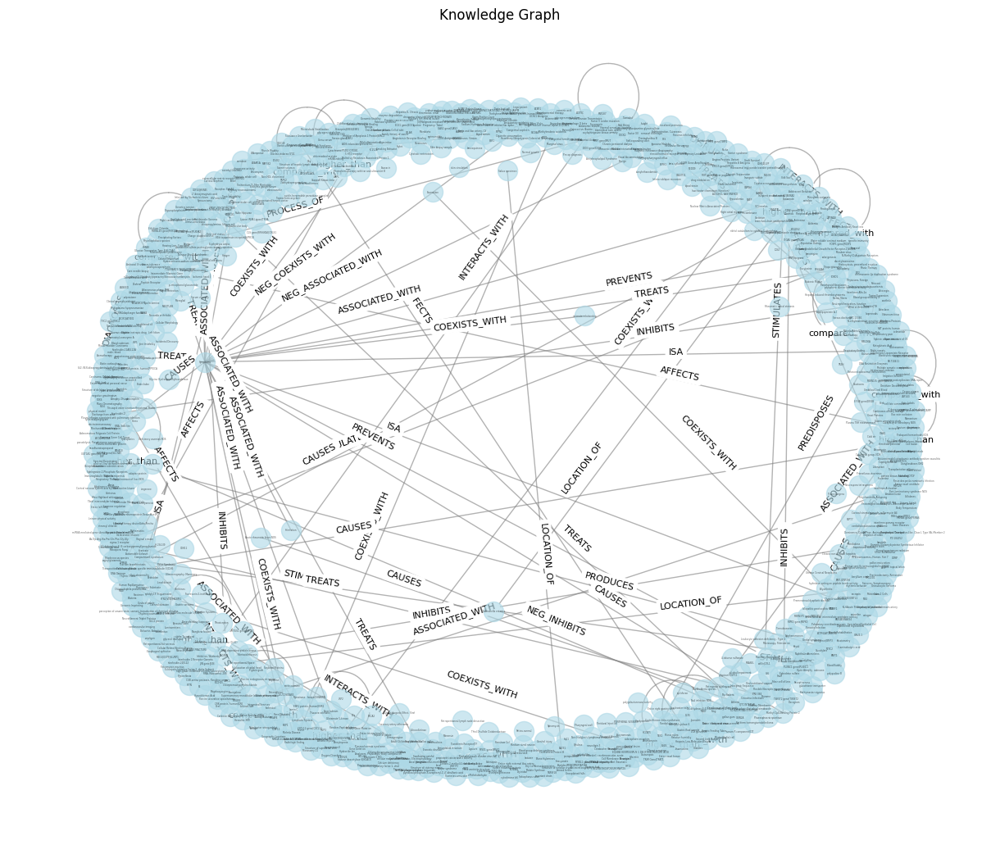

Tempo di esecuzione: -1.8939158916473389 secondi


In [13]:
start_time = time.time()

# Visualize the knowledge graph

# Creiamo un subgraph per la visualizzazione con massimo 200 nodi
nodes_of_interest = random.sample(G.nodes(), min(1000, len(G)))
subgraph = G.subgraph(nodes_of_interest)
pos = nx.spring_layout(subgraph, seed=42, k=0.9)
labels = nx.get_edge_attributes(subgraph, 'label')
plt.figure(figsize=(12, 10))
nx.draw(subgraph, pos, with_labels=True, font_size=2, node_size=300, node_color='lightblue', edge_color='gray', alpha=0.6)
nx.draw_networkx_edge_labels(subgraph, pos, edge_labels=labels, font_size=8, label_pos=0.3, verticalalignment='baseline')
plt.title('Knowledge Graph')
plt.show()
execution_time = end_time - start_time
print(f"Tempo di esecuzione: {execution_time} secondi")

# Dataset Claims
 *  Claims: https://huggingface.co/datasets/health_fact/viewer/default/test

In [14]:
df = pd.read_csv('/content/drive/MyDrive/Tesi & Stage/Code/PUBHEALTH/train.tsv', sep='\t', nrows = 500) #nrows = 500 per provare
df.head()

,claim_id,claim,date_published,explanation,fact_checkers,main_text,sources,label,subjects
0,15661,"""The money the Clinton Foundation took from fr...","April 26, 2015","""Gingrich said the Clinton Foundation """"took m...",Katie Sanders,"""Hillary Clinton is in the political crosshair...",https://www.wsj.com/articles/clinton-foundatio...,false,"Foreign Policy, PunditFact, Newt Gingrich,"
1,9893,Annual Mammograms May Have More False-Positives,"October 18, 2011",This article reports on the results of a study...,,While the financial costs of screening mammogr...,,mixture,"Screening,WebMD,women's health"
2,11358,SBRT Offers Prostate Cancer Patients High Canc...,"September 28, 2016",This news release describes five-year outcomes...,"Mary Chris Jaklevic,Steven J. Atlas, MD, MPH,K...",The news release quotes lead researcher Robert...,https://www.healthnewsreview.org/wp-content/up...,mixture,"Association/Society news release,Cancer"
3,10166,"Study: Vaccine for Breast, Ovarian Cancer Has ...","November 8, 2011","While the story does many things well, the ove...",,"The story does discuss costs, but the framing ...",http://clinicaltrials.gov/ct2/results?term=can...,true,"Cancer,WebMD,women's health"
4,11276,Some appendicitis cases may not require ’emerg...,"September 20, 2010",We really don’t understand why only a handful ...,,"""Although the story didn’t cite the cost of ap...",,true,


In [15]:
print(len(df))
print(df.columns)

500
Index(['claim_id', 'claim', 'date_published', 'explanation', 'fact_checkers',
       'main_text', 'sources', 'label', 'subjects'],
      dtype='object')


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 9 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   claim_id        500 non-null    int64 
 1   claim           500 non-null    object
 2   date_published  399 non-null    object
 3   explanation     500 non-null    object
 4   fact_checkers   500 non-null    object
 5   main_text       500 non-null    object
 6   sources         500 non-null    object
 7   label           500 non-null    object
 8   subjects        500 non-null    object
dtypes: int64(1), object(8)
memory usage: 35.3+ KB


In [17]:
df[['claim']]

,claim
0,"""The money the Clinton Foundation took from fr..."
1,Annual Mammograms May Have More False-Positives
2,SBRT Offers Prostate Cancer Patients High Canc...
3,"Study: Vaccine for Breast, Ovarian Cancer Has ..."
4,Some appendicitis cases may not require ’emerg...
...,...
495,Study: Dark chocolate improves blood vessel he...
496,"""In August 2017, NASA scientists declared that..."
497,Drug may slow growth of early prostate cancer
498,"""DeAnna Lorraine Says of COVID-19 that Dr. Ant..."


## Estrazione Triple

## Spacy

In [18]:
# Converti tutti i valori nella colonna 'claim' in stringhe
df['claim'] = df['claim'].astype(str)

In [ ]:
len(triple_list_with_id)

In [ ]:
# Estrazione da risolvere!

In [ ]:
# Funzione per estrarre le triple da una frase
def estrai_tripla_da_frase(frase):
    doc = nlp(frase)
    triple = []
    for sentence in doc.sents:
        soggetto = ""
        predicato = ""
        oggetto = ""
        for token in sentence:
            if "subj" in token.dep_:
                soggetto = token.text
            elif "obj" in token.dep_:
                oggetto = token.text
            elif "ROOT" in token.dep_:
                predicato = token.text
        if soggetto and predicato and oggetto:
            triple.append((soggetto, predicato, oggetto))
    return triple

# Applica la funzione alle frasi nel dataframe
df['triple'] = df['claim'].apply(estrai_tripla_da_frase)

# Visualizza il dataframe con le triple estratte
(df[['claim', 'triple']])

## Spacy & Bert / BioBert

In [ ]:
# Carica il modello pre-addestrato BioBERT
model_name = "dmis-lab/biobert-large-cased-v1.1"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)


In [ ]:
# Carica il modello pre-addestrato BioBERT
model_name = "dmis-lab/biobert-large-cased-v1.1"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)

# Funzione per estrarre relazioni tra entità mediche considerando il contesto e le entità vicine in una frase
def estrai_relazioni_mediche_da_frase(frase):
    # Estrai entità dal testo utilizzando spaCy
    doc = nlp(frase)
    entities = [(ent.text, ent.start, ent.end) for ent in doc.ents]

    # Identifica relazioni tra entità utilizzando verbi nella struttura grammaticale della frase
    relations = []
    for verb in doc:
        if verb.pos_ == "VERB":
            for i, entity1 in enumerate(entities):
                for j, entity2 in enumerate(entities):
                    if i < j and abs(entity1[2] - entity2[1]) <= 5:  # Verifica la vicinanza delle entità
                        if entity1[1] < verb.i < entity2[1]:
                            relation_type = verb.text  # Usa il verbo come tipo di relazione
                            relations.append((entity1[0], relation_type, entity2[0]))

    return relations

In [ ]:
# Estrai relazioni per ciascuna frase nella colonna "claims"
for index, frase in enumerate(df['claim']):
    relations = estrai_relazioni_mediche_da_frase(frase)
    print(f"Frase {index + 1}: {frase}")
    print("Relazioni estratte:", relations)
    print("-----")

In [ ]:
# Carica il tokenizer e il modello BERT preaddestrato
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

# Funzione per estrarre relazioni tra entità mediche considerando il contesto e le entità vicine in una frase
def estrai_relazioni_mediche_da_frase(frase):
    # Estrai entità dal testo utilizzando spaCy
    doc = nlp(frase)
    entities = [(ent.text, ent.start, ent.end) for ent in doc.ents]

    # Identifica relazioni tra entità utilizzando verbi nella struttura grammaticale della frase
    relations = []
    for verb in doc:
        if verb.pos_ == "VERB":
            for i, entity1 in enumerate(entities):
                for j, entity2 in enumerate(entities):
                    if i < j and abs(entity1[2] - entity2[1]) <= 5:  # Verifica la vicinanza delle entità
                        if entity1[1] < verb.i < entity2[1]:
                            relation_type = verb.text  # Usa il verbo come tipo di relazione
                            relations.append((entity1[0], relation_type, entity2[0]))

    return relations

# Estrai relazioni per ciascuna frase nella colonna "claims"
for index, frase in enumerate(df['claim']):
    relations = estrai_relazioni_mediche_da_frase(frase)
    print(f"Frase {index + 1}: {frase}")
    print("Relazioni estratte:", relations)
    print("-----")

## NltK

In [ ]:
import nltk
from nltk import pos_tag, RegexpParser, word_tokenize

nltk.download('punkt')
nltk.download('maxent_ne_chunker')
nltk.download('words')
nltk.download('averaged_perceptron_tagger')

In [ ]:
# Funzione per estrarre triple soggetto-predicato-oggetto utilizzando NLTK
def extract_subject_predicate_object(sentence):
    words = word_tokenize(sentence)
    tagged_words = pos_tag(words)

    # Definisci il pattern per il chunking degli NP (soggetti e oggetti)
    grammar = r"""NP: {<DT>?<JJ>*<NN>}
    """
    chunk_parser = RegexpParser(grammar)
    tree = chunk_parser.parse(tagged_words)

    subject = ""
    predicate = ""
    obj = ""

    for subtree in tree:
        if isinstance(subtree, nltk.Tree):
            if subtree.label() == 'NP':
                # Se l'NP è il soggetto, estrailo
                if not subject:
                    subject = " ".join(word for word, tag in subtree.leaves())
                # Se l'NP è l'oggetto, estrailo
                elif not obj:
                    obj = " ".join(word for word, tag in subtree.leaves())
            else:
                # Il resto viene considerato il predicato
                predicate = " ".join(word for word, tag in subtree.leaves())

    return subject, predicate, obj

In [ ]:
for sentence in df['claim']:
    subject, predicate, obj = extract_subject_predicate_object(sentence)
    print(f"{subject}, {predicate}, {obj}")

## Nltk with POS

In [ ]:
from nltk import pos_tag, RegexpParser, word_tokenize

In [ ]:

# Scarica i dati necessari per NLTK (puoi farlo una sola volta)
nltk.download('punkt')

# Definisci il pattern di chunking per l'estrazione delle triple
grammar = r"""
    NP: {<DT>?<JJ>*<NN|NNS>}  # Chunk gli NP: articolo, aggettivi, sostantivi singolari/plurali
        {<NNP>+}              # Chunk le sequenze di nomi propri come un'unica entità
    VP: {<VB.*><DT>?<JJ>*<NN|NNS>}  # Chunk i VP: verbo, articolo, aggettivi, sostantivi singolari/plurali
"""

# Inizializza il parser di chunking
chunk_parser = RegexpParser(grammar)

# Funzione per estrarre la tripla soggetto-predicato-oggetto da una frase
def extract_triple(sentence):
    tokens = word_tokenize(sentence)
    pos_tags = pos_tag(tokens)
    tree = chunk_parser.parse(pos_tags)

    subject = ""
    predicate = ""
    obj = ""

    for subtree in tree:
        if isinstance(subtree, nltk.Tree):
            if subtree.label() == 'NP':
                subject = " ".join(word for word, tag in subtree.leaves())
            elif subtree.label() == 'VP':
                predicate = " ".join(word for word, tag in subtree.leaves())
        else:
            # Considera solo i token non appartenenti a un albero (altri token nella frase)
            if isinstance(subtree, tuple):
                obj += subtree[0] + " "

    obj = obj.strip()  # Rimuovi spazi bianchi extra dalla fine

    return subject, predicate, obj

# Esegui l'estrazione delle triple per ogni riga nel dataset
triples = []
for index, row in df.iterrows():
    claim = row['claim']
    subject, predicate, obj = extract_triple(claim)
    triples.append((subject, predicate, obj))

# Aggiungi le triple come nuove colonne al DataFrame
df['subject'] = [triple[0] for triple in triples]
df['predicate'] = [triple[1] for triple in triples]
df['object'] = [triple[2] for triple in triples]

# Visualizza le prime righe del DataFrame con le triple
df[['claim','subject','predicate','object']]

In [ ]:
# Scarica i dati necessari per NLTK (puoi farlo una sola volta)
nltk.download('punkt')

# Definisci un pattern di chunking più dettagliato per l'estrazione delle triple
grammar = r"""
    NP: {<DT|JJ|NN.*>+}             # Chunk gli NP: determinanti, aggettivi, sostantivi
    VP: {<VB.*><DT|JJ|NN.*>+}       # Chunk i VP: verbi, determinanti, aggettivi, sostantivi
"""

# Inizializza il parser di chunking
chunk_parser = RegexpParser(grammar)

# Funzione per estrarre la tripla soggetto-predicato-oggetto da una frase
def extract_triple(sentence):
    tokens = word_tokenize(sentence)
    pos_tags = pos_tag(tokens)
    tree = chunk_parser.parse(pos_tags)

    subject = ""
    predicate = ""
    obj = ""

    for subtree in tree:
        if isinstance(subtree, nltk.Tree):
            if subtree.label() == 'NP':
                subject = " ".join(word for word, tag in subtree.leaves())
            elif subtree.label() == 'VP':
                predicate = " ".join(word for word, tag in subtree.leaves())
        else:
            # Considera solo i token non appartenenti a un albero (altri token nella frase)
            if isinstance(subtree, tuple):
                obj += subtree[0] + " "

    obj = obj.strip()  # Rimuovi spazi bianchi extra dalla fine

    return subject, predicate, obj

# Esegui l'estrazione delle triple per ogni riga nel dataset
triples = []
for index, row in df.iterrows():
    claim = row['claim']
    subject, predicate, obj = extract_triple(claim)
    triples.append((subject, predicate, obj))

# Aggiungi le triple come nuove colonne al DataFrame
df['subject'] = [triple[0] for triple in triples]
df['predicate'] = [triple[1] for triple in triples]
df['object'] = [triple[2] for triple in triples]

# Visualizza le prime righe del DataFrame con le triple
df[['claim','subject','predicate','object']]